# Exploratory Data Analysis on Dataset - Terrorism

# Author: Nikhil Raj

**Problem Statement:** As a security/defense analyst, try to find out the hot zone of terrorism. <br>

You can choose any of the tool of your choice (Python/R/Tableau/PowerBI/Excel/SAP/SAS)
<br>
Dataset: https://bit.ly/2TK5Xn5

# EDA

Exploratory Data Analysis (EDA) refers to the critical process of performing initial investigations on data so as to discover patterns,to spot anomalies,to test hypothesis and to check assumptions with the help of summary statistics and graphical representations.

In [1]:
# Importing all the important Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns 
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go
from collections import Counter

import warnings
warnings.filterwarnings('ignore')

# Loading Dataset

In [2]:
# Read the CSV file
dataset=pd.read_csv('globalterrorismdb.csv',encoding='ISO-8859-1',low_memory=False)
dataset.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
dataset.shape

(181691, 135)

In [4]:
dataset.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [5]:
#Restructuring the necessary columns

dataset.rename(columns={'iyear':'Year','imonth':'Month','city':'City','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
dataset['Casualities'] = dataset.Killed + dataset.Wounded
dataset=dataset[['Year','Month','Day','Country','Region','City','latitude','longitude','AttackType','Killed','Wounded','Casualities','Target','Group','Target_type','Weapon_type']]
dataset.head(10)

,Year,Month,Day,Country,Region,City,latitude,longitude,AttackType,Killed,Wounded,Casualities,Target,Group,Target_type,Weapon_type
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,1.0,Julio Guzman,MANO-D,Private Citizens & Property,Unknown
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,Government (Diplomatic),Unknown
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,1.0,Employee,Unknown,Journalists & Media,Unknown
3,1970,1,0,Greece,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,NaN,U.S. Embassy,Unknown,Government (Diplomatic),Explosives
4,1970,1,0,Japan,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,NaN,U.S. Consulate,Unknown,Government (Diplomatic),Incendiary
5,1970,1,1,United States,North America,Cairo,37.005105,-89.176269,Armed Assault,0.0,0.0,0.0,Cairo Police Headquarters,Black Nationalists,Police,Firearms
6,1970,1,2,Uruguay,South America,Montevideo,-34.891151,-56.187214,Assassination,0.0,0.0,0.0,Juan Maria de Lucah/Chief of Directorate of in...,Tupamaros (Uruguay),Police,Firearms
7,1970,1,2,United States,North America,Oakland,37.791927,-122.225906,Bombing/Explosion,0.0,0.0,0.0,Edes Substation,Unknown,Utilities,Explosives
8,1970,1,2,United States,North America,Madison,43.076592,-89.412488,Facility/Infrastructure Attack,0.0,0.0,0.0,"R.O.T.C. offices at University of Wisconsin, M...",New Year's Gang,Military,Incendiary
9,1970,1,3,United States,North America,Madison,43.072950,-89.386694,Facility/Infrastructure Attack,0.0,0.0,0.0,Selective Service Headquarters in Madison Wisc...,New Year's Gang,Government (General),Incendiary


In [6]:
#Checking for Missing data:

dataset.isnull().sum()

Year               0
Month              0
Day                0
Country            0
Region             0
City             434
latitude        4556
longitude       4557
AttackType         0
Killed         10313
Wounded        16311
Casualities    16874
Target           636
Group              0
Target_type        0
Weapon_type        0
dtype: int64

In [10]:
dataset.shape

(159946, 16)

In [11]:
#Removing the Missing data:
dataset.dropna(axis=0, inplace=True)
dataset.shape

(159946, 16)

In [12]:
#Re-Checking for Missing Data:
dataset.isnull().sum()

Year           0
Month          0
Day            0
Country        0
Region         0
City           0
latitude       0
longitude      0
AttackType     0
Killed         0
Wounded        0
Casualities    0
Target         0
Group          0
Target_type    0
Weapon_type    0
dtype: int64

In [17]:
dataset["Year"].value_counts()

2014    14905
2015    13369
2016    12307
2013    11338
2017     9835
2012     8092
2011     4885
1992     4794
2010     4724
2009     4452
2008     4426
1991     4294
1989     4101
1990     3627
1988     3408
1994     3130
2007     2907
1995     2870
1987     2834
1996     2784
1997     2767
1984     2492
2006     2444
1986     2261
1985     2196
1979     2087
1980     2011
2005     1829
1981     1779
2001     1777
1983     1700
2000     1602
1982     1542
1978     1237
1999     1232
2002     1227
2003     1158
1977     1076
2004     1022
1998      761
1976      598
1970      569
1975      388
1974      344
1971      316
1973      225
1972      224
Name: Year, dtype: int64

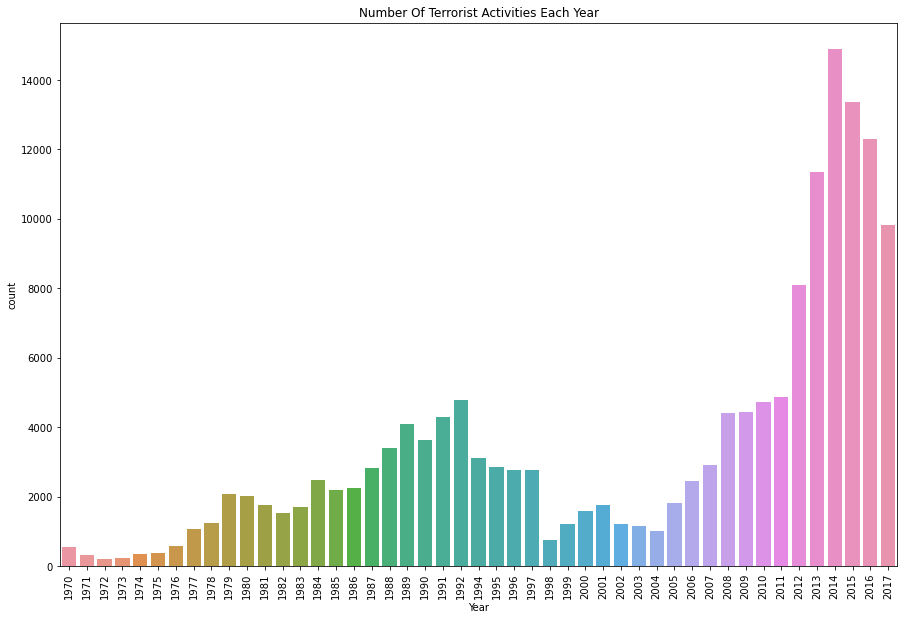

In [11]:
#Yearly Count of Terrorist Attack-

plt.figure(figsize=(15,10))
sns.countplot(x="Year", data=dataset)
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

The Above Bar Graph shows how the cases of Terrorism is rising yearly. <br>
We can clearly see the rise of terrorism from **2004 to 2014.** <br>
There has been a gradual increase in Terror Activities since 2004. <br>
Highest number of terror activities occurred in the year 2014. <br>
After 2014 the terror activities started to decrease.


In [20]:
dataset[dataset["Year"]==2015].shape

(13369, 16)

In [19]:
dataset[dataset["Year"]==2014].shape

(14905, 16)

Let's have a month analysis to have a more clearer view over the Monthly casualitites.

In [15]:
dataset["Month"].value_counts().sort_index()

0         7
1     13001
2     12243
3     13230
4     13327
5     14641
6     13590
7     14425
8     13947
9     12590
10    13730
11    13273
12    11942
Name: Month, dtype: int64

We see 7 month values which lies in '0' month column which is pretty much comes under irrelevant data category. <br>
Let's remove it

In [18]:
dataset[dataset["Month"] == 0]

,Year,Month,Day,Country,Region,City,latitude,longitude,AttackType,Killed,Wounded,Casualities,Target,Group,Target_type,Weapon_type
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,Government (Diplomatic),Unknown
1123,1972,0,0,Philippines,Southeast Asia,Roxas,11.586558,122.753716,Bombing/Explosion,0.0,0.0,0.0,air manila fokker F-27p,Unknown,Airports & Aircraft,Explosives
2164,1974,0,0,France,Western Europe,Paris,48.856644,2.342330,Bombing/Explosion,0.0,0.0,0.0,Bank Lazard,Unknown,Business,Explosives
2165,1974,0,0,Italy,Western Europe,Rome,41.890961,12.490069,Bombing/Explosion,0.0,0.0,0.0,TWA Boeing 707,Unknown,Airports & Aircraft,Explosives
4410,1977,0,0,France,Western Europe,Bayonne,43.492949,-1.474841,Bombing/Explosion,0.0,0.0,0.0,Newspaper Sud Ouest,Basque Rectitudes,Journalists & Media,Explosives
4411,1977,0,0,France,Western Europe,Bayonne,43.492949,-1.474841,Bombing/Explosion,0.0,0.0,0.0,Bayone Sindicate of Initiative,Basque Rectitudes,Business,Explosives
15163,1982,0,0,Canada,North America,Toronto,43.666667,-79.416667,Bombing/Explosion,0.0,0.0,0.0,consulate,Armenian Secret Army for the Liberation of Arm...,Government (Diplomatic),Explosives


In [19]:
dataset.shape

(159946, 16)

In [30]:
dataset = dataset[dataset["Month"] != 0]
dataset.shape

(159939, 16)

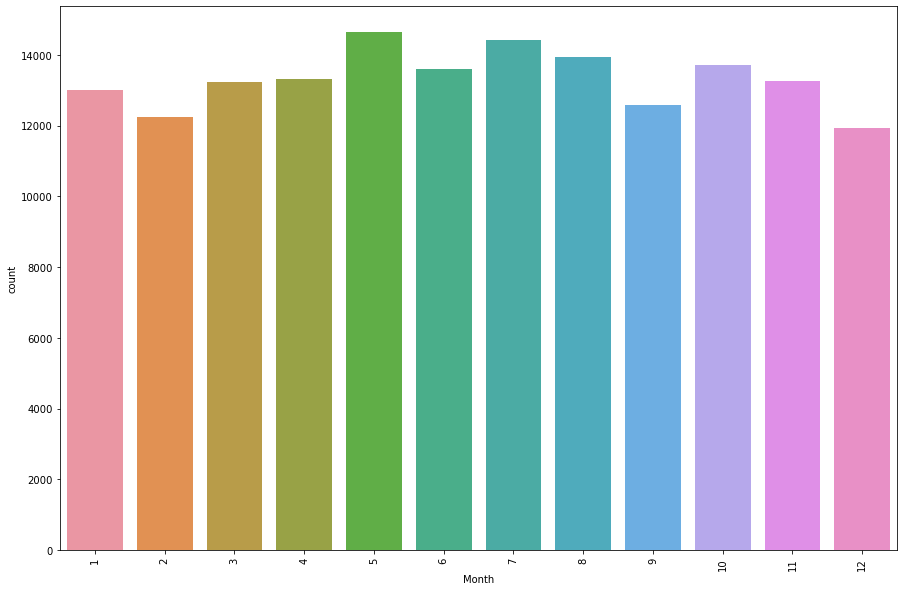

In [31]:
plt.figure(figsize = (15,10))
sns.countplot(x="Month", data= dataset)
plt.xticks(rotation = 90)
plt.show()

Terrorist Activities By Region In Each Year

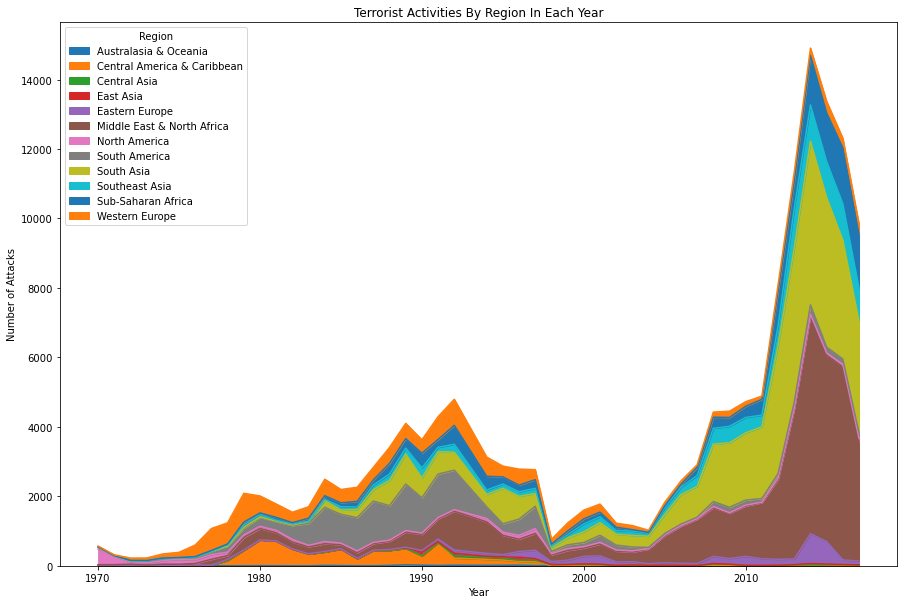

In [41]:
pd.crosstab(dataset.Year, dataset.Region).plot(kind= 'area', figsize = (15,10))
plt.title('Terrorist Activities By Region In Each Year')
plt.ylabel('Number of Attacks')
plt.show()

REGION AFFECTED BY TERRORIST ATTACK

In [42]:
dataset["Region"].value_counts()

Middle East & North Africa     45817
South Asia                     42261
South America                  16240
Sub-Saharan Africa             13833
Western Europe                 13812
Southeast Asia                 11225
Central America & Caribbean     7089
Eastern Europe                  4833
North America                   3281
East Asia                        744
Central Asia                     537
Australasia & Oceania            267
Name: Region, dtype: int64

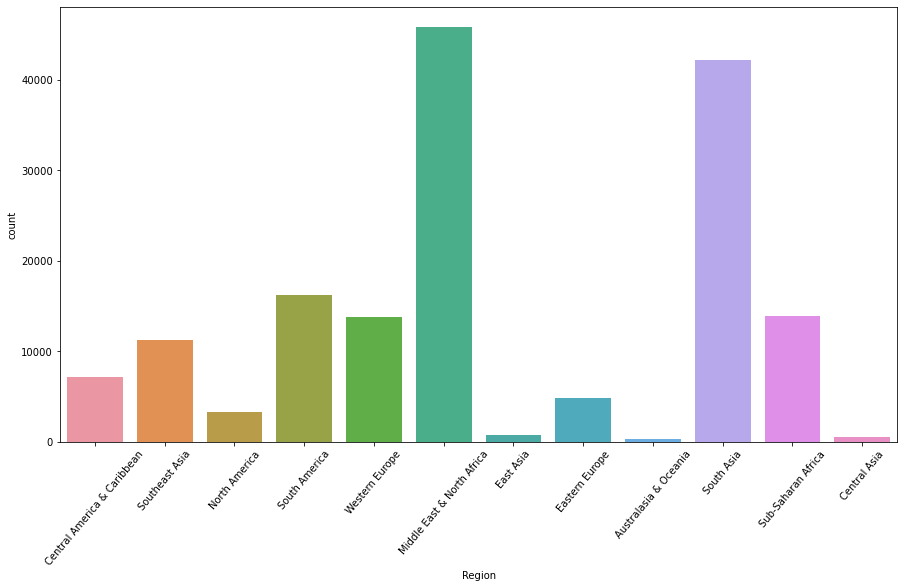

In [47]:
plt.figure(figsize = (15,8))
sns.countplot(x= "Region", data=dataset)
plt.xticks(rotation = 50)
plt.show()


Counting the Yearly Casualities-

In [54]:
year_cas = dataset.groupby("Year").Casualities.sum().to_frame().reset_index()
px.bar(data_frame = year_cas, x= "Year", y= "Casualities", color = "Casualities", template = "plotly_dark")

Conclusion: **It is observed that 2015 marks the highest Casualities records.**

Let's check the Type of Target Attacks

In [55]:
dataset["Target_type"].value_counts()

Private Citizens & Property       37463
Military                          23006
Police                            22560
Government (General)              19494
Business                          18321
Transportation                     6080
Unknown                            5525
Utilities                          4930
Religious Figures/Institutions     4142
Educational Institution            4017
Government (Diplomatic)            3269
Terrorists/Non-State Militia       2607
Journalists & Media                2596
Violent Political Party            1739
Airports & Aircraft                1140
Telecommunication                   920
NGO                                 852
Tourists                            392
Abortion Related                    258
Food or Water Supply                255
Maritime                            254
Other                               119
Name: Target_type, dtype: int64

In [58]:
target = list(dataset['Target_type'])
target_map = dict(Counter(target))
target_df = pd.DataFrame(target_map.items())
target_df.columns = ['Target Type','Count']
px.bar(data_frame=target_df,x = 'Target Type',y = 'Count',color='Target Type',template='plotly_white')

Conclusion: **Private Citizens and Property Counts the highest amongst all.**

# Analysing the Type of Attacks:-

Counting the Casuallities according the Attack Type

In [64]:
AttackType = dataset.pivot_table(columns = "AttackType", values = "Casualities", aggfunc= "sum").T
AttackType["Type"] = AttackType.index
AttackType

,Casualities,Type
AttackType,,
Armed Assault,199034.0,Armed Assault
Assassination,35847.0,Assassination
Bombing/Explosion,506464.0,Bombing/Explosion
Facility/Infrastructure Attack,6060.0,Facility/Infrastructure Attack
Hijacking,20310.0,Hijacking
Hostage Taking (Barricade Incident),7412.0,Hostage Taking (Barricade Incident)
Hostage Taking (Kidnapping),19824.0,Hostage Taking (Kidnapping)
Unarmed Assault,14554.0,Unarmed Assault
Unknown,36683.0,Unknown


Plotting the Attack type

In [65]:
labels = AttackType.columns.tolist()
attack=AttackType.T
values=attack.values.tolist()
values = sum(values,[])
attack_type = list(dataset['AttackType'].unique())
fig = go.Figure(data=[go.Pie(labels = attack_type,values=values,hole=.3)])
fig.update_layout(template = 'gridon')
fig.show()

Conclusion : **Bombing and Explosion method shows the highest chossen type.**

# Count of Weapon Chossen for Attack.

In [74]:
values = list(dataset['AttackType'])
value_map = dict(Counter(values))
value_dataset = pd.DataFrame(value_map.items())
value_dataset.columns = ["AttackType","Count of Attack Type"]
value_dataset

,AttackType,Count of Attack Type
0,Assassination,17408
1,Armed Assault,36669
2,Bombing/Explosion,80840
3,Facility/Infrastructure Attack,9465
4,Hijacking,524
5,Hostage Taking (Kidnapping),7590
6,Unknown,5770
7,Unarmed Assault,874
8,Hostage Taking (Barricade Incident),799


In [75]:
px.bar(data_frame=value_dataset,x = 'AttackType',y = 'Count of Attack Type',color = 'AttackType',template="plotly_white")

Conclusion: **Bombing and Explosion shows the highest.**

# Plotting the HOT-ZONE of Terrorism on the highest year of Terrorist Attack i.e. 2014.

In [76]:
import folium
from folium.plugins import MarkerCluster
year=dataset[dataset['Year']==2014]
mapData=year.loc[:,'City':'longitude']
mapData=mapData.dropna().values.tolist()

map = folium.Map(location = [0, 50], tiles='CartoDB positron', zoom_start=2) 
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(mapData)):
    folium.Marker(location=[mapData[point][1],mapData[point][2]],
                  popup = mapData[point][0]).add_to(markerCluster)
map

Conclusion : **Iraq shows the highest Terror Attacks followed by other Middle-east region.**

# Top 15 Countries showing the Highest Terror Attack.

In [107]:
plt.figure(figsize=(15,6))
country_attack=dataset.Country.value_counts()[:15].reset_index()
country_attack.columns= ["Country", "Total Attacks"]
px.bar(data_frame= country_attack,x = 'Country',y = 'Total Attacks',color = 'Country',template='plotly_white')

<Figure size 1080x432 with 0 Axes>

**Iraq, again the highest followed by Pakistan, Afganistan and India.**

# Counting the Total Number of Casualities in each Country.

In [108]:
plt.figure(figsize=(15, 8))
cas_count= dataset.groupby("Country").Casualities.sum().to_frame().reset_index().sort_values("Casualities", ascending=False)[:15]
px.bar(data_frame=cas_count,x = 'Country',y = 'Casualities',color='Country',template='plotly_white')

<Figure size 1080x576 with 0 Axes>

# Count of Terror Attack Region-Wise.

In [109]:
region_attacks = dataset.Region.value_counts().to_frame().reset_index()
region_attacks.columns = ['Region', 'Total Attacks']
fig = px.bar_polar(data_frame=region_attacks,r = 'Total Attacks',theta='Region',color = 'Region',
                  template="ggplot2", color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()

Conclusion : **Middle East and North Africa shows the highest followed by South Asia.**

# Final Conclusion

Hot zones of terrorism is Middle east and North Arica so,we should focus in these region. <br>
Iraq, Afganistan and Pakistan most suffered country, Government should be aware from the citizens of these countries.<br>
Terrorist like to target Private citizens, Army and Police mostly, Security should be tighten in all these areas.<br>
BOMBING and EXPLOSIVE are most used weapon and attack type b=used by terrorist.<br>
Government should tighten borders and should strict arms law.<br>
Most number of attacks were done by unknown group or not an group terrorist.<br>
All country should have to make pact to to tackle terrorism because after 2005 there is rapid increase in Terrorist Activites. <br>